

<h1 style="color: orange;">PRÁCTICA 4</h1>



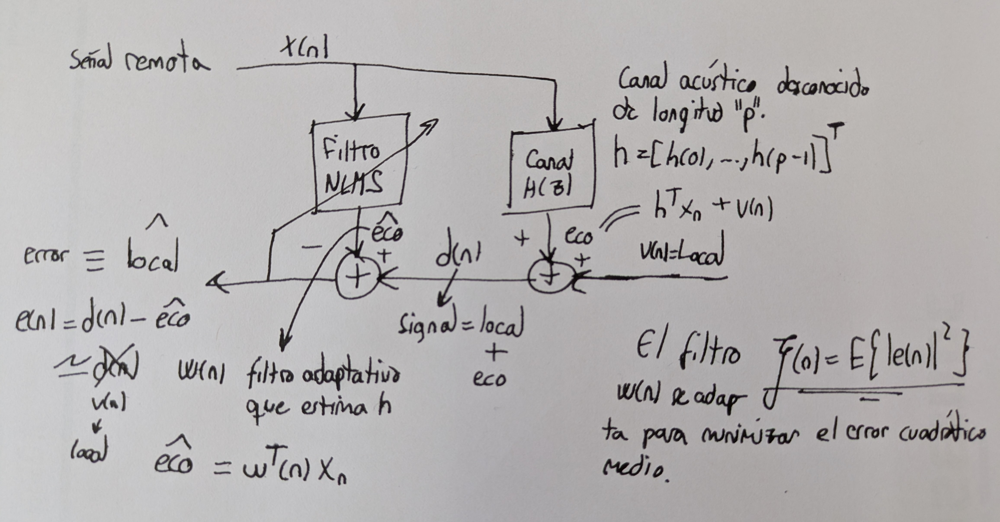

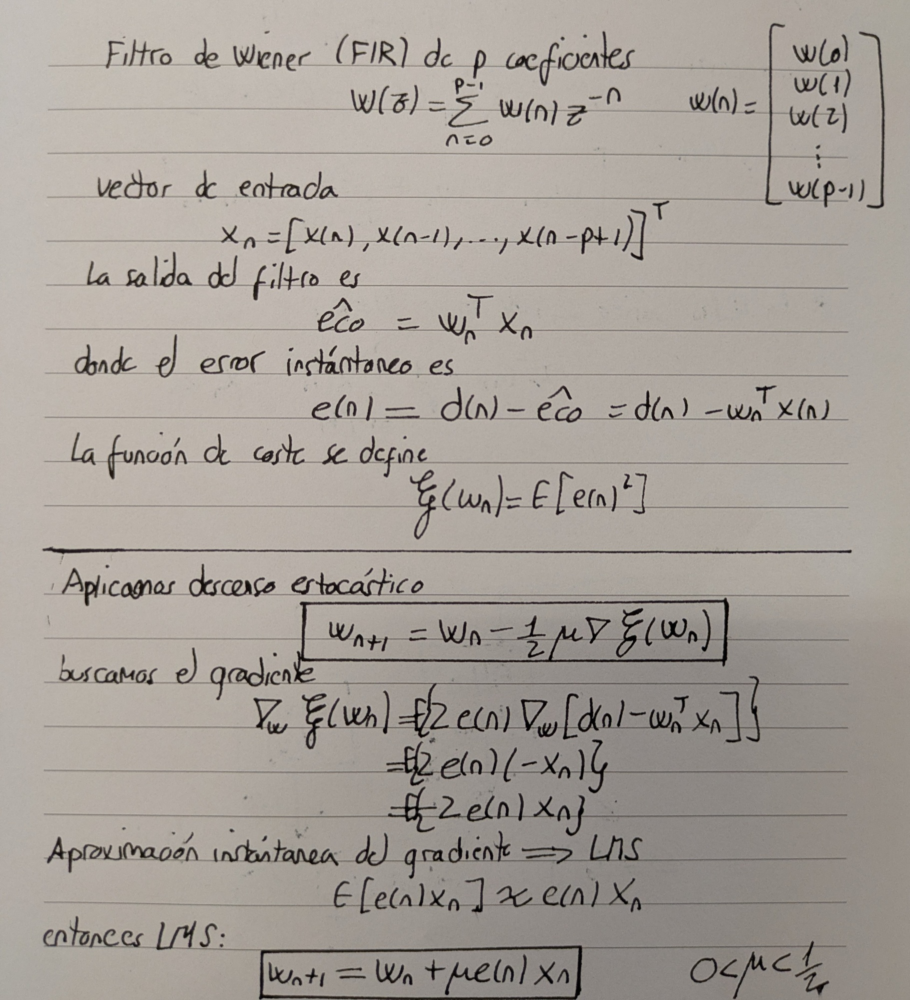

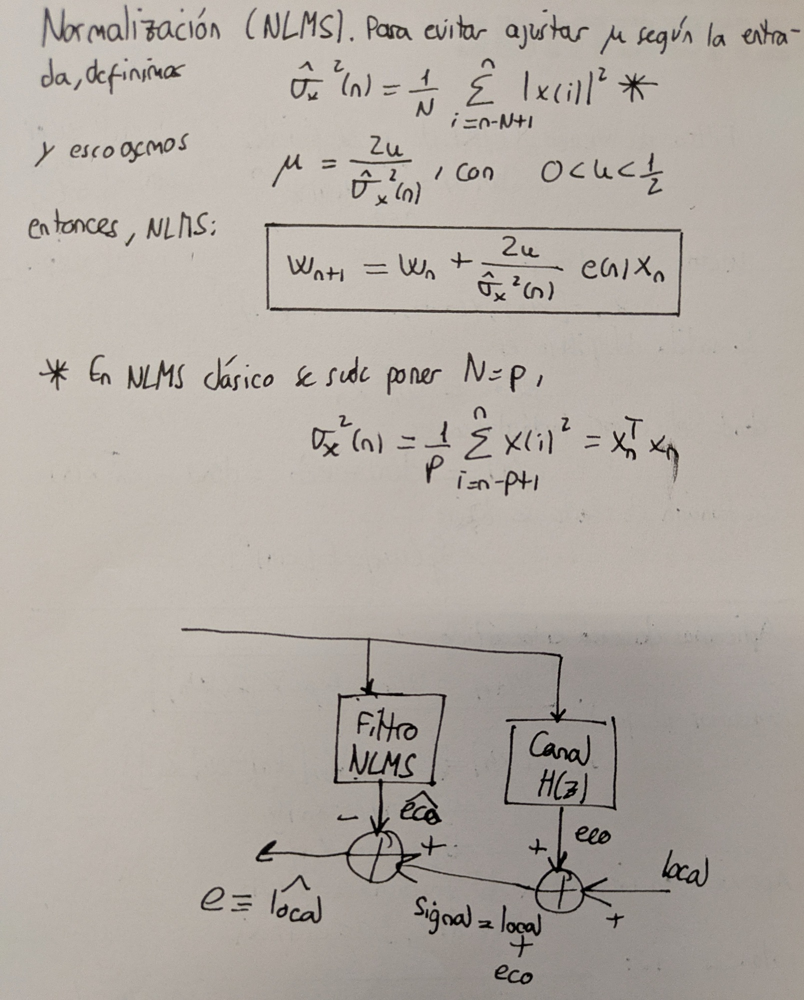

In [1]:
%reset

import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io import wavfile  # Para leer archivos .wav
from scipy.linalg import toeplitz, inv  
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation, PillowWriter
from scipy.signal import spectrogram
from scipy.signal import freqz
from IPython.display import Audio

fs_x, x = wavfile.read('data/remota.wav')
fs_d, d = wavfile.read('data/signal.wav')
fs_v, v = wavfile.read('data/local.wav')

x = x.astype(float)
d = d.astype(float)
v = v.astype(float)


<hr style="border: 1.5px solid orange;">

<h1 style="color: orange;">ACTIVIDAD 1</h1>

<hr style="border: 1.5px solid orange;">

Calcular la SNR obtenida sin cancelación del eco

La SNR entre una señal $x(n)$ y una distorsión aditiva de la misma $d(n)$ se computa como:

$$
\mathrm{SNR} = 10 \log_{10} \left( \frac{\sum_n x^2(n)}{\sum_n d^2(n)} \right)
$$

En nuestro caso, la señal $x(n)$ sería la **señal local** que se quiere transmitir, y la distorsión es $d(n) = y(n) - x(n)$, donde $y(n)$ es la señal que se transmite finalmente (en este caso sin cancelación, $y(n)$ corresponde a `signal`).


SNR sin cancelación del eco: 7.74 dB
Señal con eco (d):


Señal local (v):


Señal remota (x):


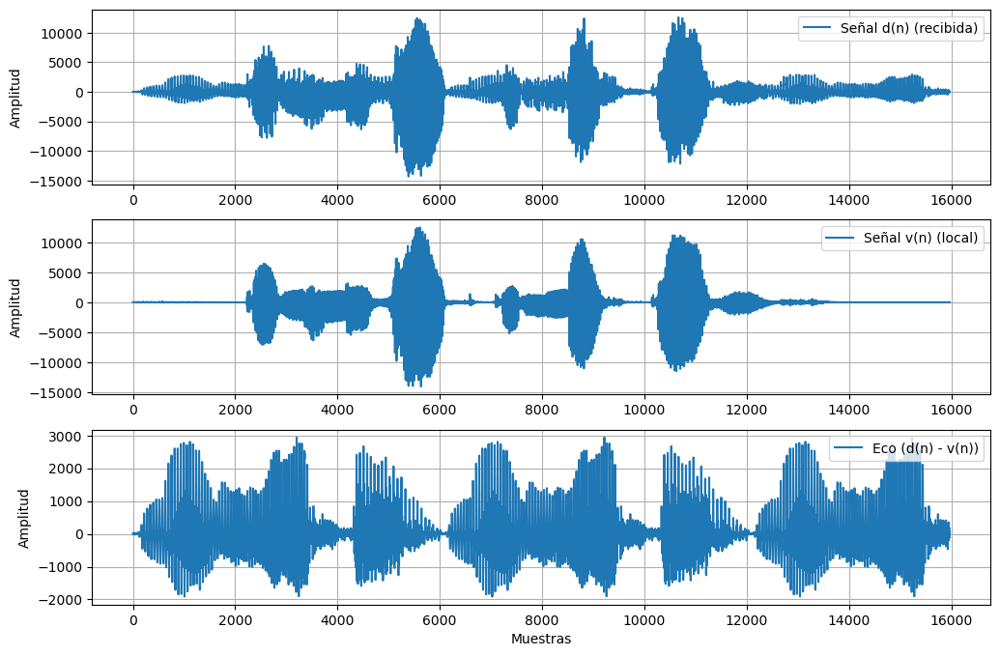

In [2]:

def snr(local, recibida):
    """
    Calcula la SNR entre la señal local y la señal recibida (con eco).
    """
    error = recibida - local
    snr = 10 * np.log10(np.sum(local ** 2) / np.sum(error ** 2))
    return snr

# Ejemplo de uso
# local: señal v(n)
# received: señal d(n) = v(n) + eco → corresponde a signal.wav

snr_sin_cancelacion = snr(v, d)
print(f"SNR sin cancelación del eco: {snr_sin_cancelacion:.2f} dB")

# Dibujar d, v y el eco
plt.figure(figsize=(12, 8))
plt.subplot(3, 1, 1)
plt.plot(d, label='Señal d(n) (recibida)')
plt.ylabel('Amplitud')
plt.legend()
plt.grid()

plt.subplot(3, 1, 2)
plt.plot(v, label='Señal v(n) (local)')
plt.ylabel('Amplitud')
plt.legend()
plt.grid()

plt.subplot(3, 1, 3)
plt.plot(d - v, label='Eco (d(n) - v(n))')
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.legend()
plt.grid()



print("Señal con eco (d):")
display(Audio(d, rate=fs_d))

print("Señal local (v):")
display(Audio(v, rate=fs_v))

print("Señal remota (x):")
display(Audio(x, rate=fs_x))

<hr style="border: 1.5px solid orange;">

<h1 style="color: orange;">ACTIVIDAD 2</h1>

<hr style="border: 1.5px solid orange;">

Implementar el cancelador con el algoritmo NLMS inicializando el filtro con un vector de ceros. Buscar el parámetro de convergencia ($\mu = 0.0005, 0.001, 0.002, 0.004, 0.008, \dots, 0.128$) y el orden del filtro ($p = 2, 3, \dots, 7$) que proporcionen una mejor **SNR** (en este caso $y(n)$ es la señal con eco cancelado, que coincide con la señal error).

Dibujar la evolución temporal de los coeficientes del filtro (para la configuración de mejor SNR) y comentar el resultado.  

Escribir la señal local estimada (con eco cancelado) del mejor caso en un fichero formato `.wav` (`signal_canceled.wav`), y escuchar y comentar el resultado.


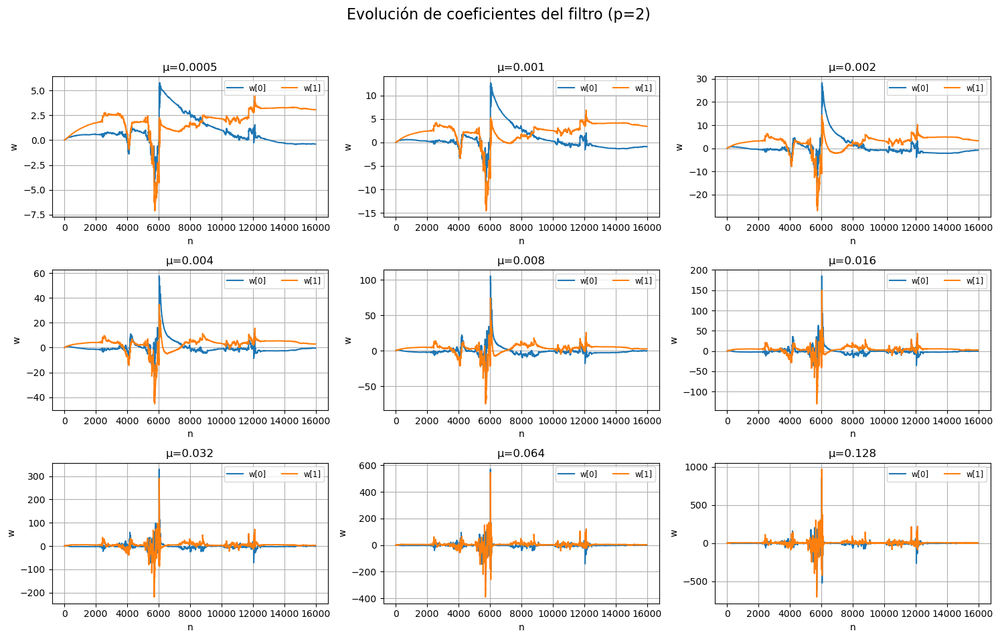

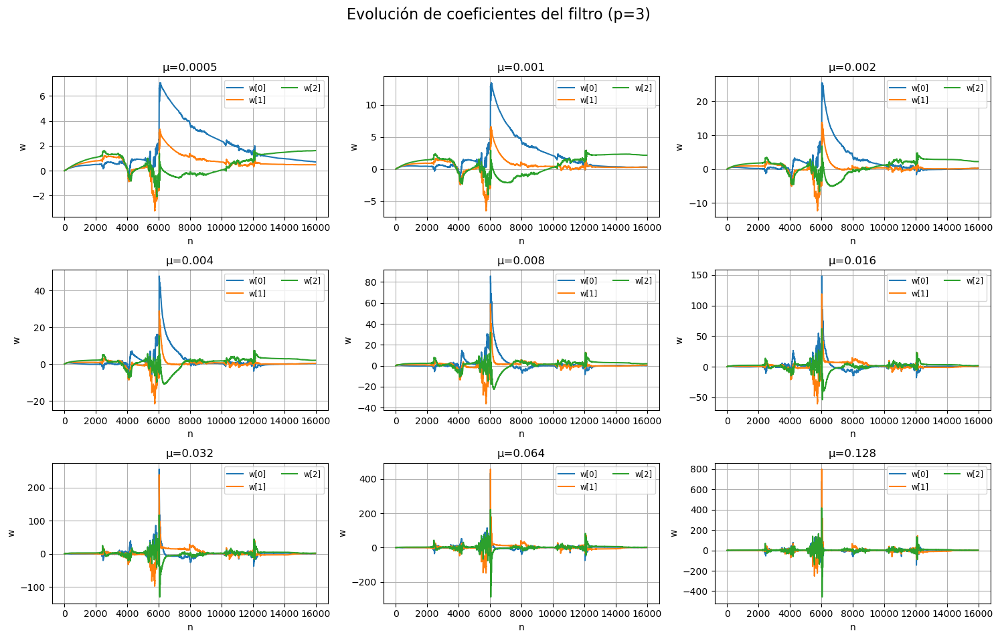

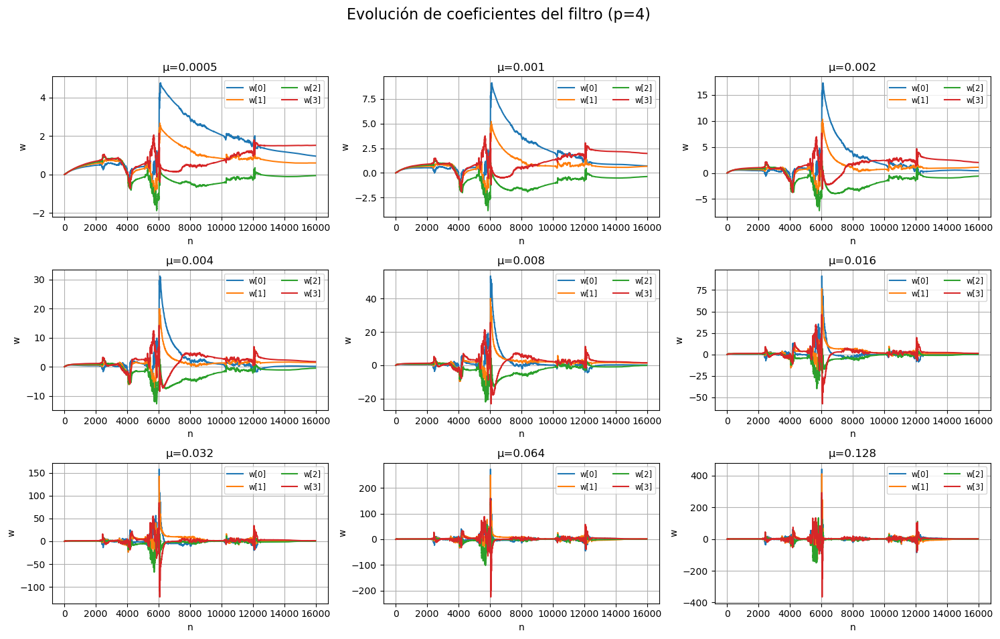

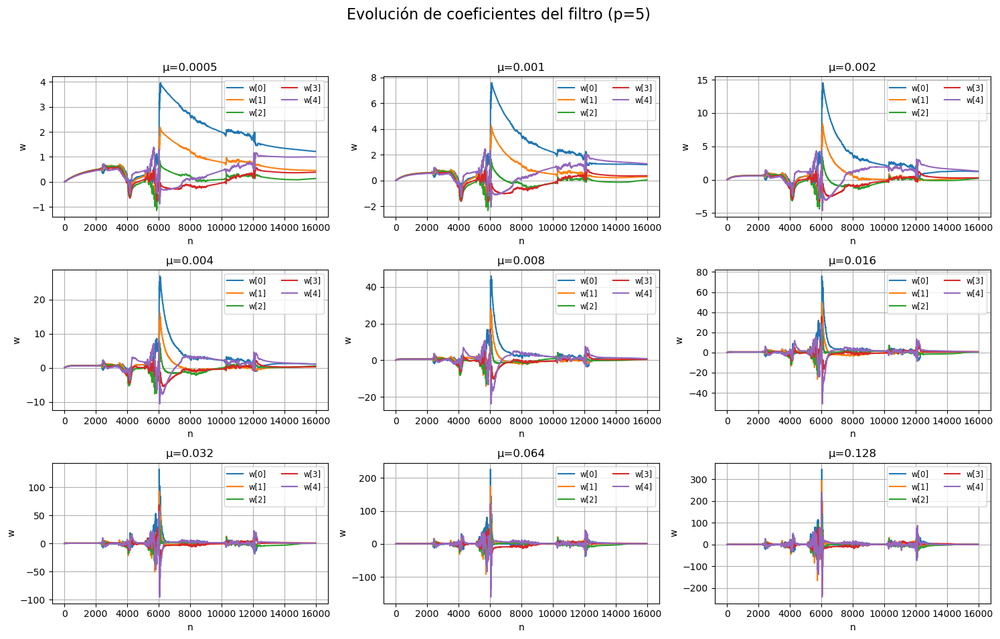

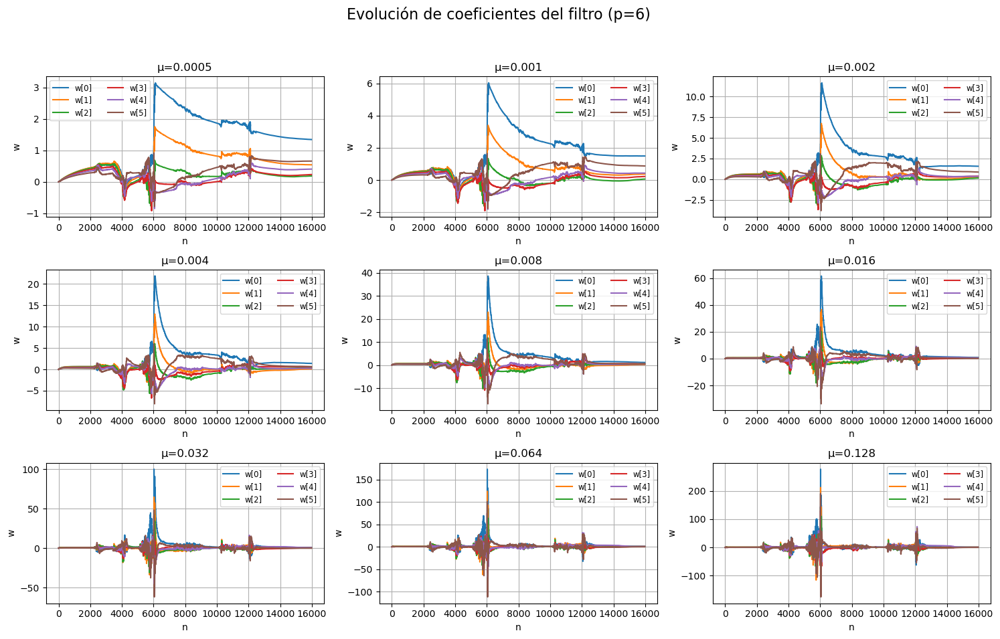

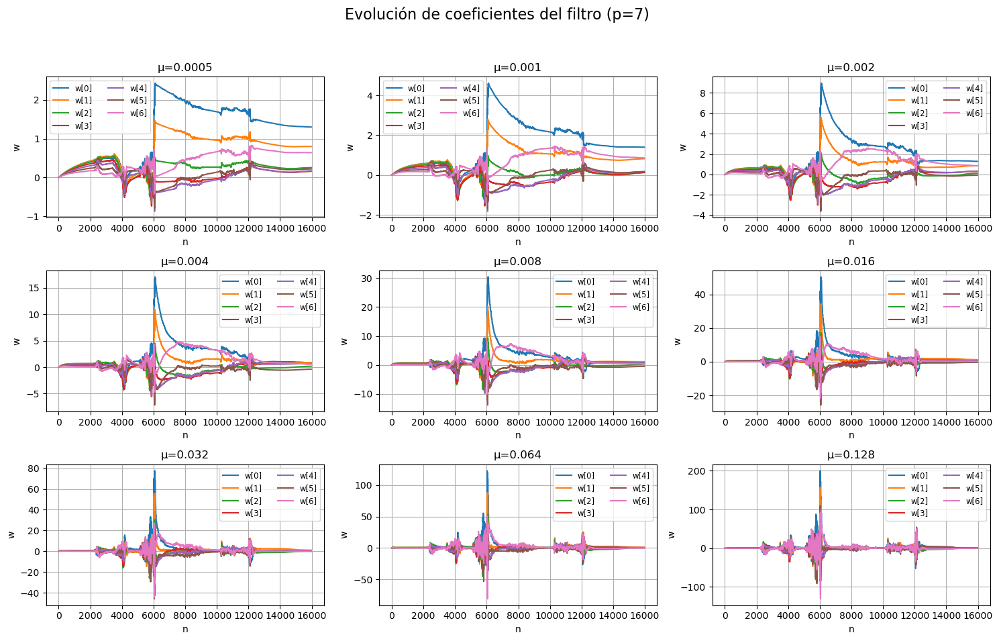

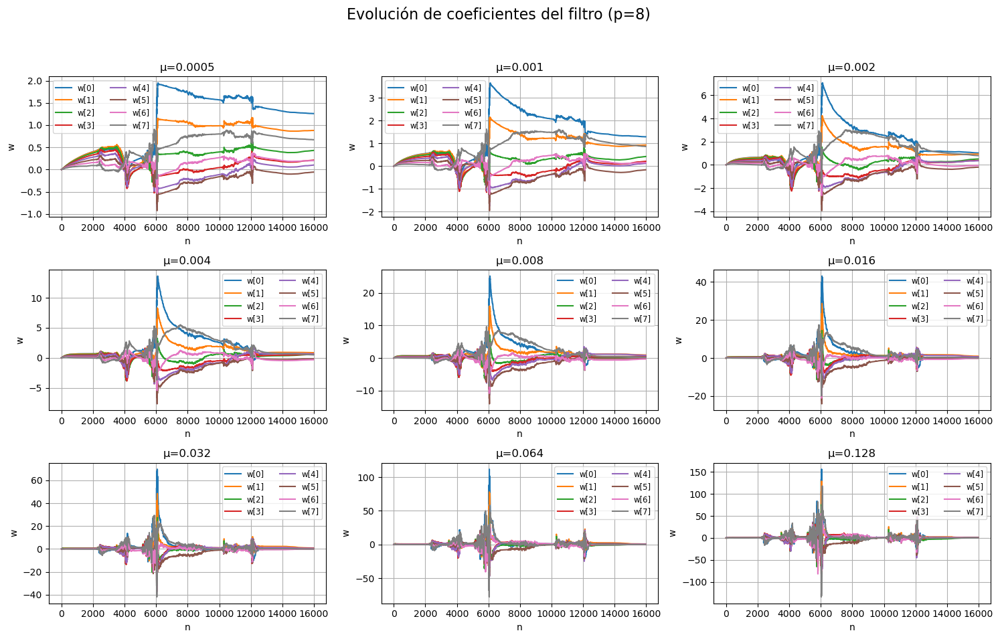

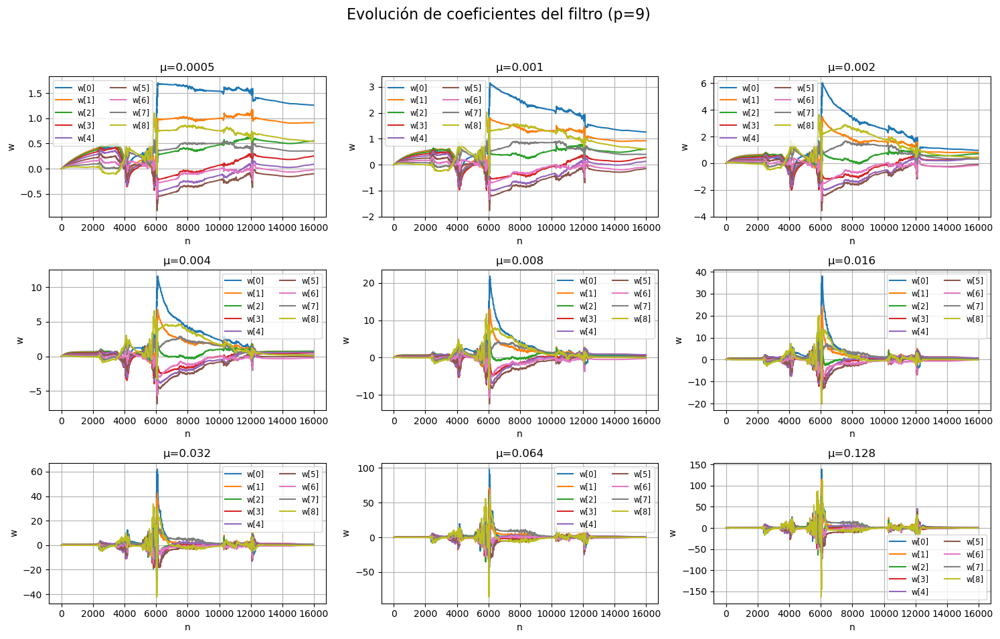

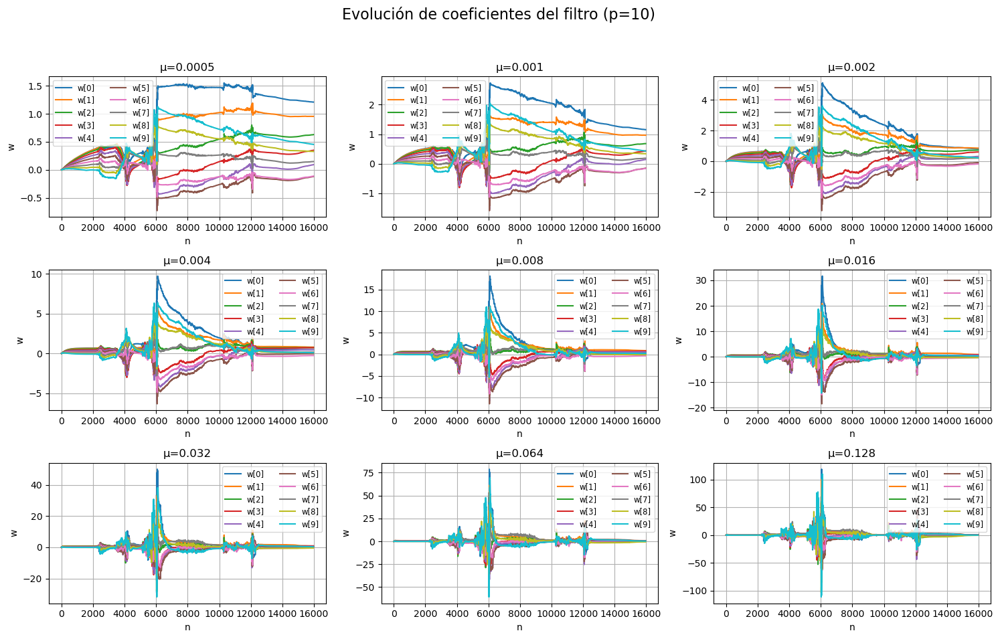

Máxima SNR: 14.57 dB
Se alcanza con p = 8 y μ = 0.0005


In [ ]:

#! Filtro NLMS - Descenso estocástico
p_vect = np.array([2, 3, 4, 5, 6, 7, 8, 9, 10]) # Orden del filtro 
u_vect = np.array([0.0005, 0.001, 0.002, 0.004, 0.008, 0.016, 0.032, 0.064, 0.128]) # Tasa de aprendizaje


SNR = np.zeros((len(p_vect), len(u_vect))) # Inicializar matriz SNR

for i, p in enumerate(p_vect):
    fig, axs = plt.subplots(nrows=3, ncols=3, figsize=(15, 10)) 
    fig.suptitle(f'Evolución de coeficientes del filtro (p={p})', fontsize=16)
    axs = axs.flatten()
    
    for j, u in enumerate(u_vect):
        e = np.zeros(len(d)) 
        w = np.zeros(p) 
        w_hist = np.zeros((len(d), p))
        
        for idx, n in enumerate(range(0, len(d))):
                                     #p-1
            if n < p-1:
                x_p = x[:n+1][::-1]
                x_p = np.concatenate((x_p, np.zeros(p-n-1)))
            else:
                x_p = x[n-p+1 : n+1][::-1]

            eco_hat = w.T @ x_p
            hat_sigma2 = x_p @ x_p.T
            e[n] = d[n] - eco_hat 

            w = w + (2*u / (hat_sigma2+1e-9)) * e[n] * x_p
            w_hist[idx] = w
            
            
        SNR[i, j] = snr(v, e)

        ax = axs[j]
        for k in range(p):
            ax.plot(range(len(d)), w_hist[:, k], label=f'w[{k}]')
        ax.set_title(f'μ={u}')
        ax.set_xlabel('n')
        ax.set_ylabel('w')
        ax.grid(True)
        ax.legend(fontsize='small', ncol=2)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # deja espacio para el título
    plt.show()

max_snr = np.max(SNR)
max_idx = np.unravel_index(np.argmax(SNR), SNR.shape)

best_p = p_vect[max_idx[0]]
best_mu = u_vect[max_idx[1]]

print(f"Máxima SNR: {max_snr:.2f} dB")
print(f"Se alcanza con p = {best_p} y μ = {best_mu}")


In [37]:

P, U = np.meshgrid(u_vect, p_vect)

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')

# Cambiar cmap a 'autumn_r' (inverso del rojo-amarillo)
surf = ax.plot_surface(U, P, SNR, cmap='autumn_r')

ax.set_ylabel('Tasa de aprendizaje (μ)')
ax.set_xlabel('Orden del filtro (p)')
ax.set_zlabel('SNR (dB)', labelpad=15)
ax.set_title('SNR en función de orden y tasa de aprendizaje')

def update(angle):
    ax.view_init(elev=30, azim=angle)
    return fig,

ani = FuncAnimation(fig, update, frames=np.arange(0, 360, 2), interval=100)
ani.save("snr_plus_rotation_autumn.gif", writer=PillowWriter(fps=10))

plt.close(fig)

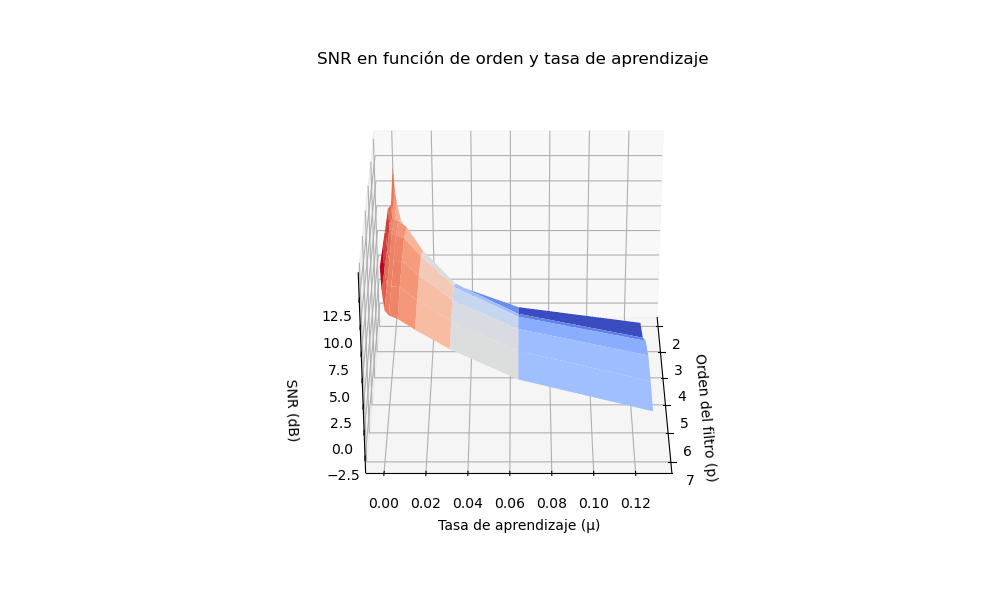

In [ ]:
print("Señal ecualizada (e):")
display(Audio(e, rate=fs_d))

Señal ecualizada (e):


<hr style="border: 1.5px solid orange;">

<h1 style="color: orange;">ACTIVIDAD 3</h1>

<hr style="border: 1.5px solid orange;">


Repetir el apartado anterior suponiendo que un detector de *double talk* (DTD) detecta voz local a partir de la muestra número 2150, de forma que el filtro sólo se adapta hasta esta muestra (para instantes posteriores se mantiene fijo el último cancelador obtenido). Comentar los resultados obtenidos y compararlos con los del apartado anterior.

Dibujar la respuesta en frecuencia del cancelador FIR fijado para los instantes posteriores al 2150 (para el caso con mejor SNR). Comentar qué tipo de filtro es, y qué nos dice esta respuesta en frecuencia sobre la respuesta en frecuencia del *canal desconocido* que transforma la señal remota en el eco que contamina a la señal local.


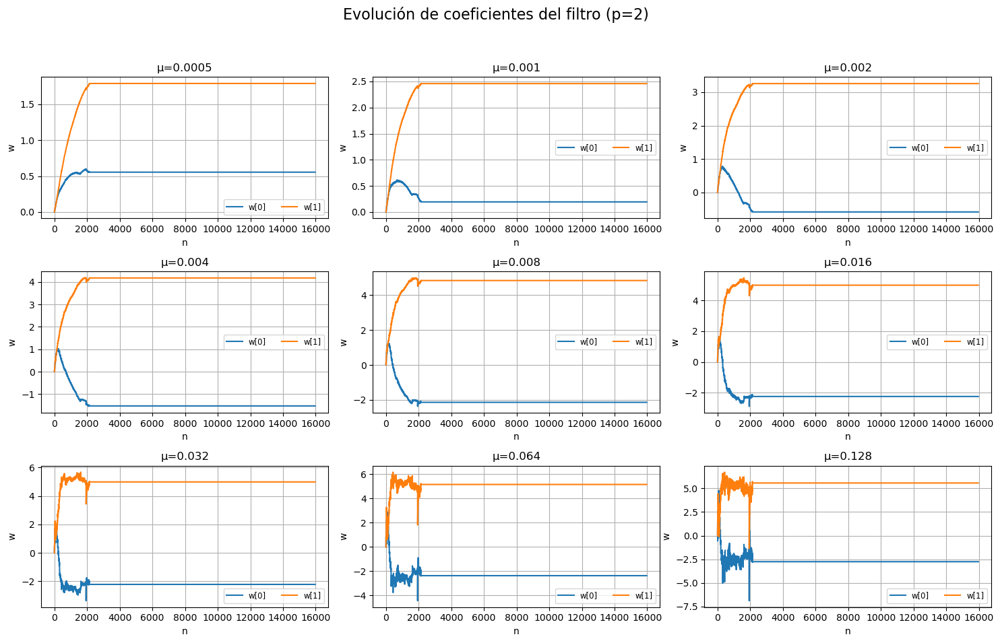

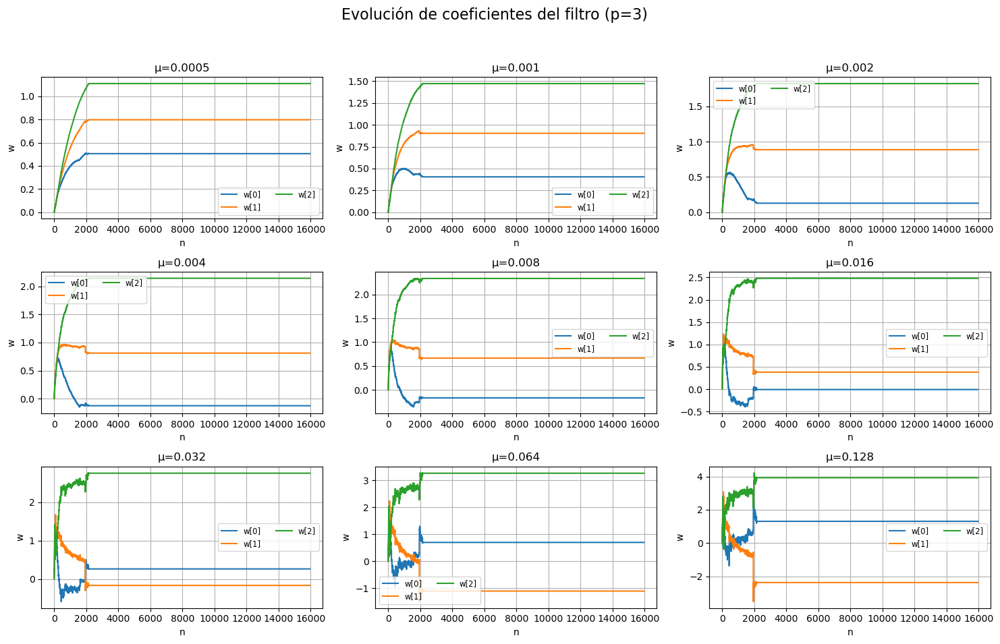

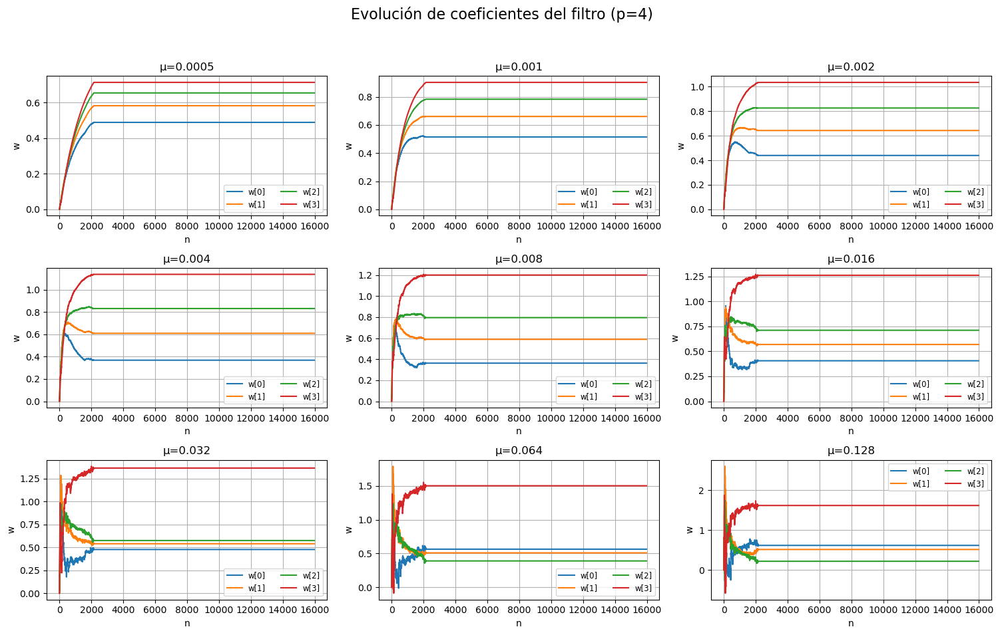

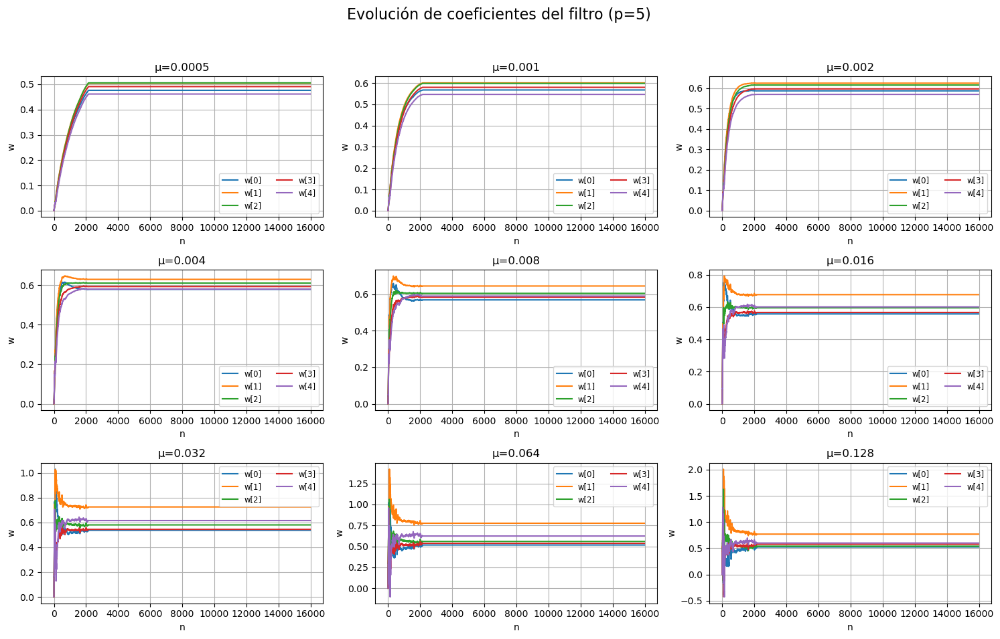

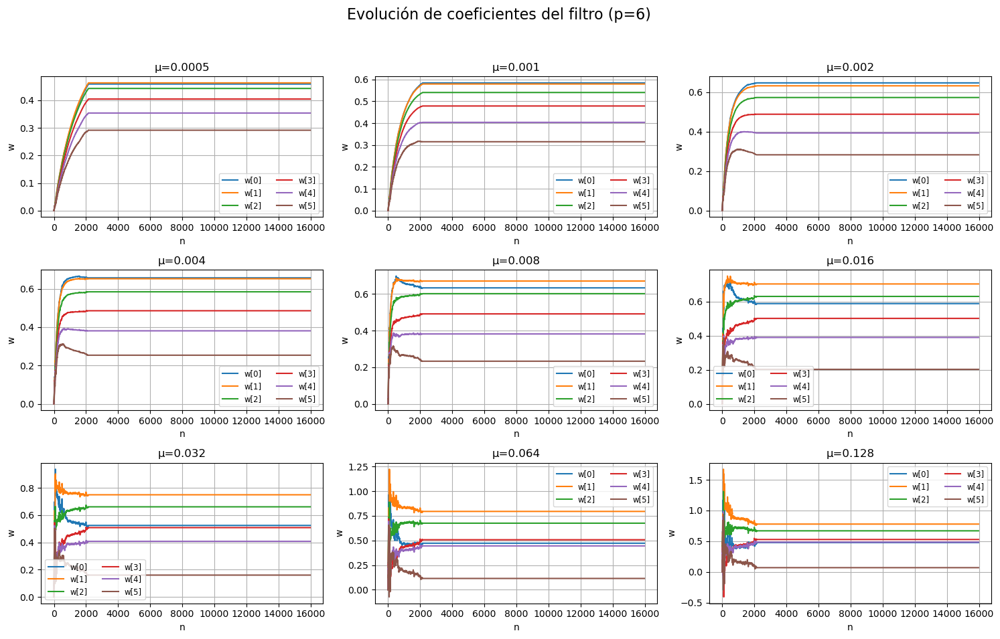

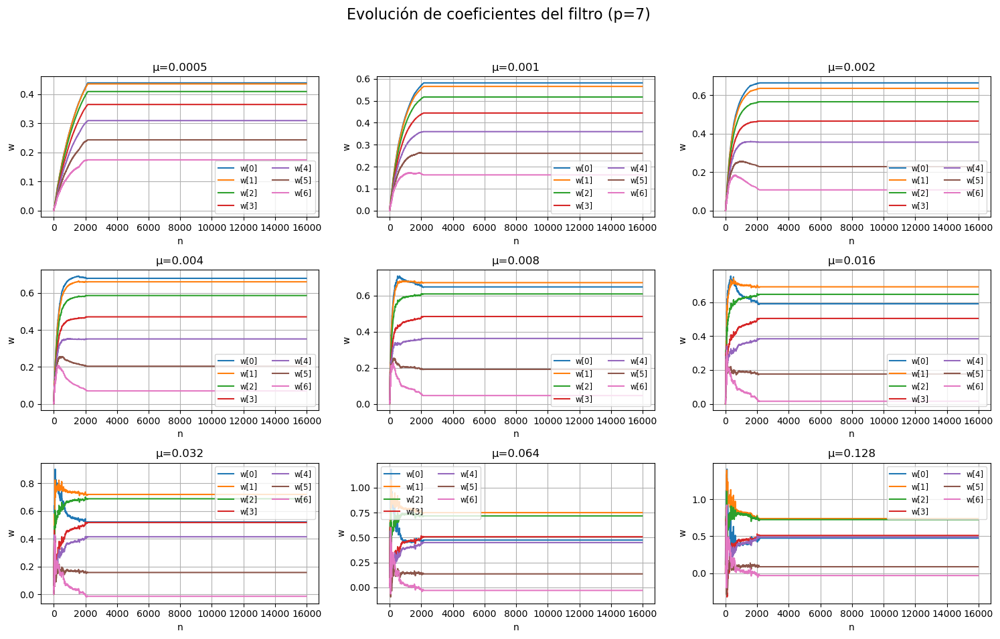

Máxima SNR: 47.87 dB
Se alcanza con p = 5 y μ = 0.008


In [4]:

#! Ahora Double Talk (DTD)
p_vect = np.array([2, 3, 4, 5, 6, 7]) # Orden del filtro 
u_vect = np.array([0.0005, 0.001, 0.002, 0.004, 0.008, 0.016, 0.032, 0.064, 0.128]) # Tasa de aprendizaje

DTD = 2150 #! Importante DTD >= p
SNR_DTD = np.zeros((len(p_vect), len(u_vect))) # Inicializar matriz SNR

for i, p in enumerate(p_vect):
    fig, axs = plt.subplots(nrows=3, ncols=3, figsize=(15, 10)) 
    fig.suptitle(f'Evolución de coeficientes del filtro (p={p})', fontsize=16)
    axs = axs.flatten()
    
    for j, u in enumerate(u_vect):
        e = np.zeros(len(d)) 
        w = np.zeros(p) 
        w_hist = np.zeros((len(d), p))
                                     #p-1
        for idx, n in enumerate(range(0, len(d))):           
            if n < DTD:                         
                if n < p-1:
                    x_p = x[:n+1][::-1]
                    x_p = np.concatenate((x_p, np.zeros(p-n-1)))
                else:
                    x_p = x[n-p+1 : n+1][::-1]

                eco_hat = w.T @ x_p
                hat_sigma2 = x_p @ x_p.T
                e[n] = d[n] - eco_hat

                w = w + (2*u / (hat_sigma2+1e-9)) * e[n] * x_p
                w_hist[idx] = w
            else:
                x_p = x[n-p+1 : n+1][::-1]
                
                eco_hat = w.T @ x_p
                e[n] = d[n] - eco_hat
                w_hist[idx] = w
                
                
        SNR_DTD[i, j] = snr(v, e)

        ax = axs[j]
        for k in range(p):
            ax.plot(range(len(d)), w_hist[:, k], label=f'w[{k}]')
        ax.set_title(f'μ={u}')
        ax.set_xlabel('n')
        ax.set_ylabel('w')
        ax.grid(True)
        ax.legend(fontsize='small', ncol=2)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # deja espacio para el título
    plt.show()

max_snr_DTD = np.max(SNR_DTD)
max_idx_DTD = np.unravel_index(np.argmax(SNR_DTD), SNR_DTD.shape)

best_p_DTD = p_vect[max_idx_DTD[0]]
best_mu_DTD = u_vect[max_idx_DTD[1]]

print(f"Máxima SNR: {max_snr_DTD:.2f} dB")
print(f"Se alcanza con p = {best_p_DTD} y μ = {best_mu_DTD}")


In [5]:
P, U = np.meshgrid(u_vect, p_vect)

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')

# Cambiar cmap a 'autumn_r' (inverso del rojo-amarillo)
surf = ax.plot_surface(U, P, SNR_DTD, cmap='viridis')

ax.set_ylabel('Tasa de aprendizaje (μ)')
ax.set_xlabel('Orden del filtro (p)')
ax.set_zlabel('SNR (dB)', labelpad=15)
ax.set_title('SNR en función de orden y tasa de aprendizaje')

def update(angle):
    ax.view_init(elev=30, azim=angle)
    return fig,

ani = FuncAnimation(fig, update, frames=np.arange(0, 360, 2), interval=100)
ani.save("snr_DTD_rotation.gif", writer=PillowWriter(fps=10))

plt.close(fig)

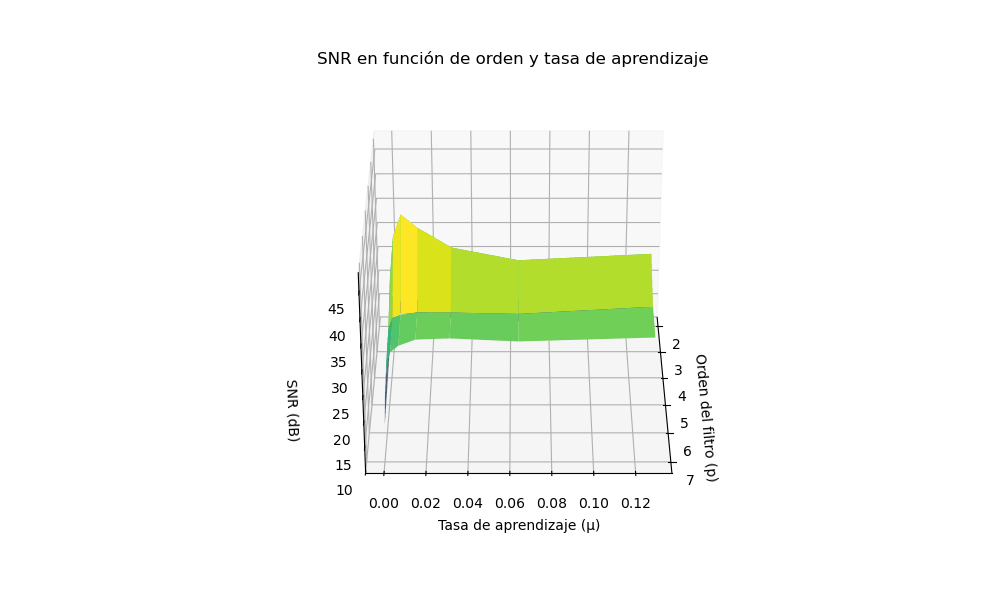

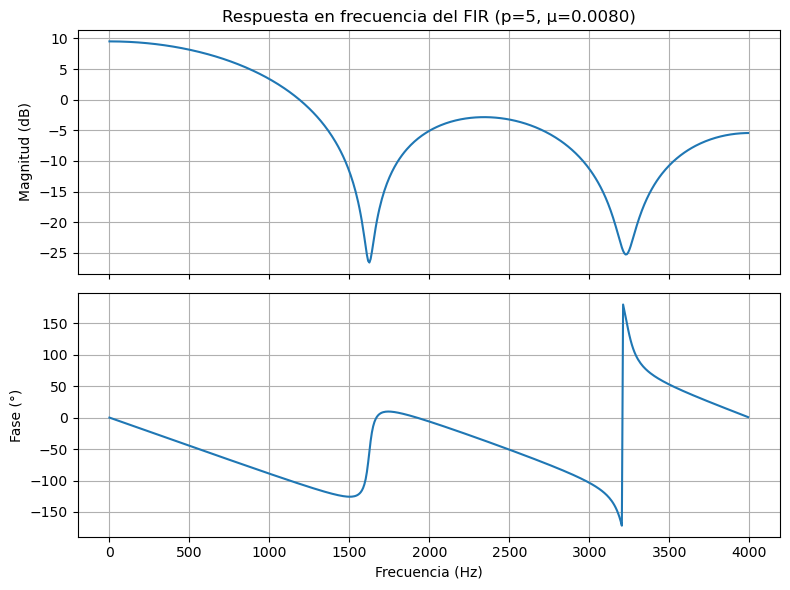

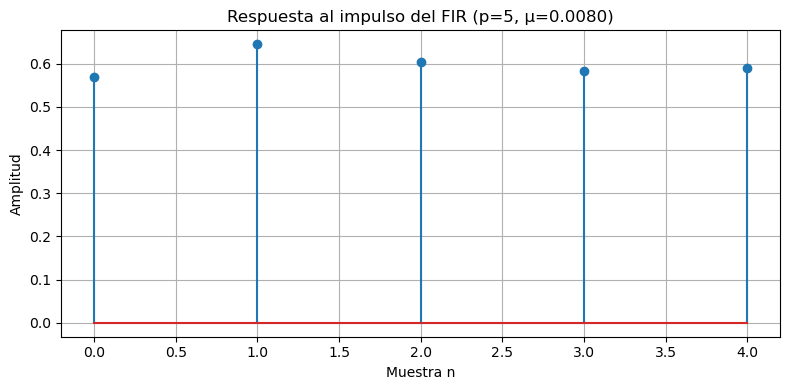

Señal ecualizada (e):


In [7]:

#? Recalcular el filtro con los mejores parámetros

u = best_mu_DTD
p = best_p_DTD

e = np.zeros(len(d)) 
w = np.zeros(p) 
w_hist = np.zeros((len(d), p))
    
for n in range(0, len(d)):           
    if n < DTD:                         
        if n < p-1:
            x_p = x[:n+1][::-1]
            x_p = np.concatenate((x_p, np.zeros(p-n-1)))
        else:
            x_p = x[n-p+1 : n+1][::-1]

        eco_hat = w.T @ x_p
        hat_sigma2 = x_p @ x_p.T
        e[n] = d[n] - eco_hat

        w = w + (2*u / (hat_sigma2+1e-9)) * e[n] * x_p
        w_hist[n] = w
    else:
        x_p = x[n-p+1 : n+1][::-1]
                
        eco_hat = w.T @ x_p
        e[n] = d[n] - eco_hat
        w_hist[n] = w
                
#? Respuesta en frecuencia del filtro adaptativo
w_freq, h = freqz(b=w, a=1, worN=512, fs=fs_x)
H_dB = 20 * np.log10(np.abs(h) + 1e-12)
phase_deg = np.angle(h, deg=True)   # fase en grados

fig, (ax1, ax2) = plt.subplots(2,1, figsize=(8,6), sharex=True)

ax1.plot(w_freq, H_dB)
ax1.set_ylabel('Magnitud (dB)')
ax1.set_title(f'Respuesta en frecuencia del FIR (p={p}, μ={u:.4f})')
ax1.grid(True)

ax2.plot(w_freq, phase_deg)
ax2.set_ylabel('Fase (°)')
ax2.set_xlabel('Frecuencia (Hz)')
ax2.grid(True)

plt.tight_layout()
plt.show()

#? Respuesta al impulso del filtro adaptativo
plt.figure(figsize=(8, 4))
plt.stem(np.arange(len(w)), w)  
plt.xlabel('Muestra n')
plt.ylabel('Amplitud')
plt.title(f'Respuesta al impulso del FIR (p={p}, μ={u:.4f})')
plt.grid(True)
plt.tight_layout()
plt.show()

print("Señal ecualizada (e):")
display(Audio(e, rate=fs_d))



Para las primeras n=2150 muestras véase que no existe señal local. No se empieza a hablar hasta la muestra n=2150. Ello implica que, si se define el error como
$$
e(n) = d(n) - \hat{\text{eco(n)}} = \text{local(n)} + \text{eco(n)} - \hat{\text{eco(n)}} = \text{local(n)} + \text{residuo(n)}_{\text{eco}}
$$
e idealmente, suponemos que
$$
e(n) = \text{local(n)},
$$
entonces, para las primeras n=2150 muestras, $e(n)=0$. Para las siguientes, si queremos minimizar el error, habrá que tratar de seguir la señal "local" ya que queda $e(n)=\text{local(n)}$. Así pues, minimizar el error consiste en "seguir" la señal "local" lo que resultará en una estimación menos precisa ya que, podemos imaginarnos, que el gradiente no seguirá con igual precisión el descenso hacia mínimo, porque este es cambiante.
